In [2]:
from graphics import * 
import pandas as pd 
import numpy as np 
from new_data_loader import bench, squat, deadlift
from data_loader import be, sq, de
import plotly.graph_objects as go
import matplotlib.pyplot as plt 

interval = 100
t = squat[0]['gravityX'].dropna().to_numpy()
bench.extend(be)
squat.extend(sq)
deadlift.extend(de)

bench = [e for e in bench if len(e['gravityX'].dropna().to_numpy()) > interval]
squat = [e for e in squat if len(e['gravityX'].dropna().to_numpy()) > interval]
deadlift = [e for e in deadlift if len(e['gravityX'].dropna().to_numpy()) > interval]

['novel', 'bench', '20', '5', 'bad-2024-10-25', '23-24-47.json']
['brian', 'bench', '35', '5', '-2024-10-25', '23-19-10.json']
['novel', 'squat', '20', '5', '-2024-10-25', '00-49-17.json']
['neal', 'bench', '0', '5', '-2024-10-25', '23-34-22.json']
['novel', 'squat', '20', '5', '-2024-10-25', '00-50-36.json']
['neal', 'deadlift', '25', '5', '-2024-10-25', '23-50-52.json']
['novel', 'deadlift', '35', '5', '-2024-10-25', '00-11-12.json']
['brian', 'deadlift', '60', '5', '-2024-10-25', '23-48-04.json']
['novel', 'deadlift', '35', '5', '-2024-10-25', '00-12-44.json']
['brian', 'bench', '45', '5', '-2024-10-25', '23-39-37.json']
['brian', 'squat', '35', '5', '-2024-10-25', '00-22-02.json']
['novel', 'deadlift', '25', '5', '-2024-10-25', '00-09-36.json']
['novel', 'deadlift', '40', '5', '-2024-10-25', '00-14-48.json']
['brian', 'deadlift', '35', '5', '-2024-10-25', '23-43-11.json']
['neal', 'bench', '10', '5', '-2024-10-25', '23-34-56.json']
['neal', 'squat', '15', '4', '-2024-10-25', '00-39

In [3]:
def eye_diag(sig, interval):
    if interval not in sig.shape:
        sig = sig.reshape(-1, 1)
        padding = np.zeros((interval - sig.shape[0] % interval, sig.shape[1]))
        sig = np.concatenate([sig, padding], axis=0)
        sig = sig.reshape(-1, interval, sig.shape[1])
        sig = np.squeeze(sig)

    fig = go.Figure()
    print(sig.shape)
    for e in sig:
        fig.add_trace(
            go.Scatter(x=list(range(len(e))), y=e)
        )
    
    fig.update_layout(
        height=600, 
        title="Gravity Signals Over Time",
        xaxis_title="Time Steps",
        hovermode="x unified", 
    )
    
    fig.show()

(13, 100)


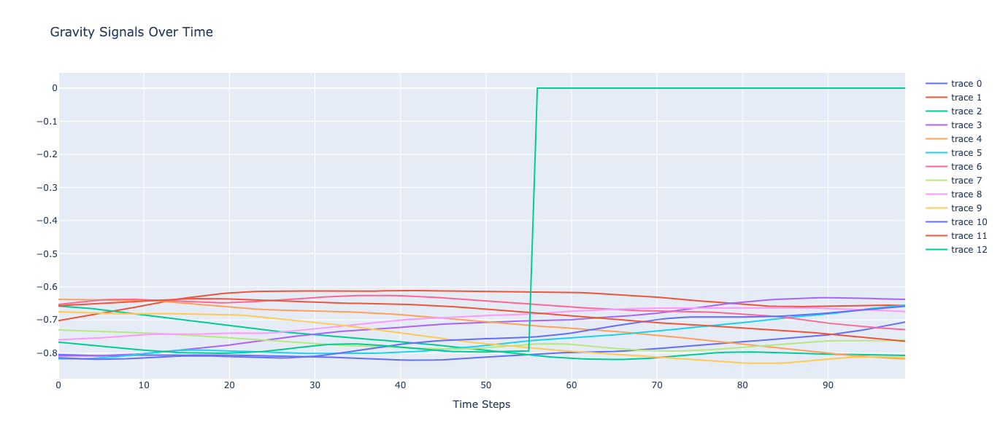

In [4]:
eye_diag(t, interval)

(21, 100)


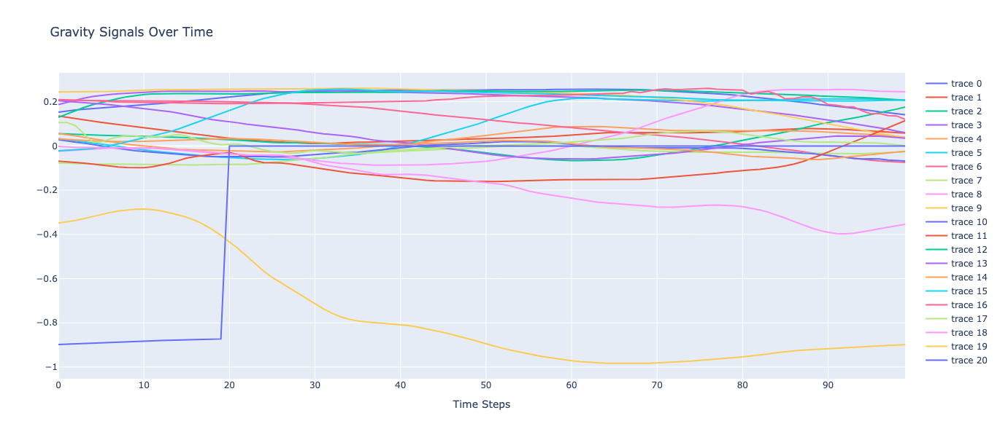

In [5]:
t = bench[0]['gravityY'].dropna().to_numpy()
eye_diag(t, interval)

(8, 256)


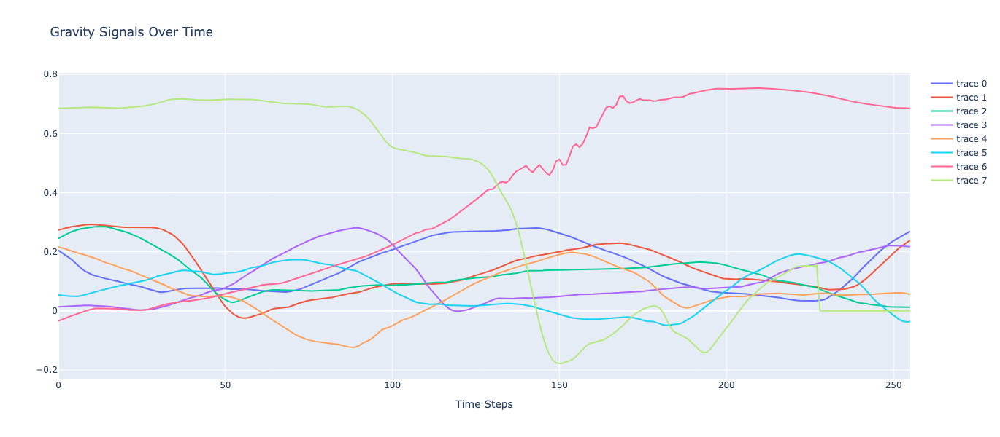

In [6]:
t = bench[0]['gravityZ'].dropna().to_numpy()
eye_diag(t, 256)

(13, 100)


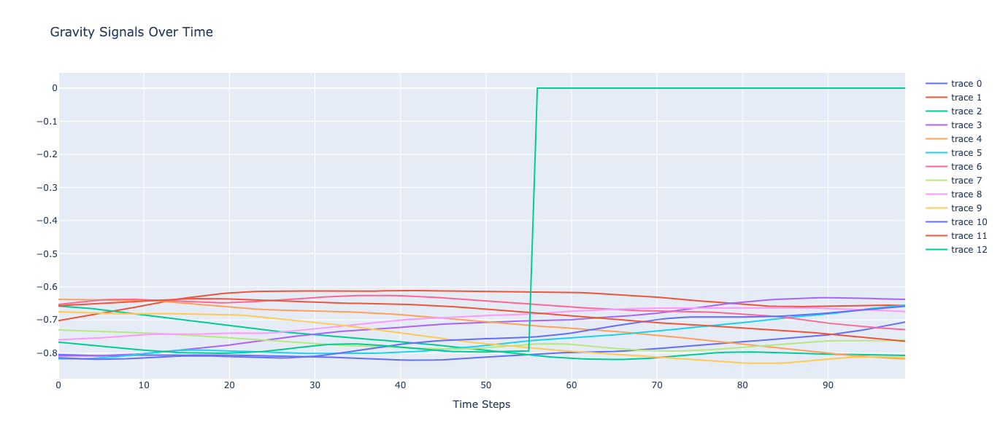

In [7]:
t = squat[0]['gravityX'].dropna().to_numpy()
eye_diag(t, interval)

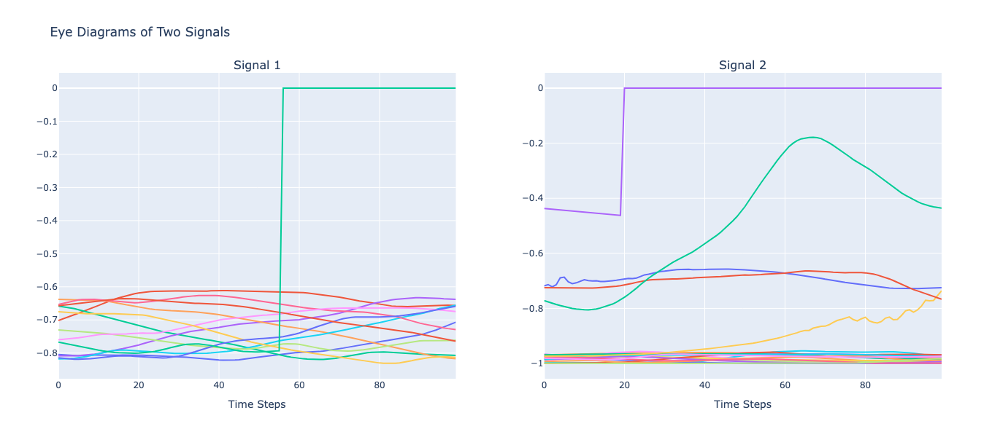

In [8]:
def eye_diag_2(sig1, sig2, interval):
    def process_signal(sig, interval):
        if interval not in sig.shape:
            sig = sig.reshape(-1, 1)
        pad_len = interval - (sig.shape[0] % interval)
        if pad_len != interval:
            padding = np.zeros((pad_len, sig.shape[1]))
            sig = np.concatenate([sig, padding], axis=0)
        sig = sig.reshape(-1, interval, sig.shape[1])
        sig = np.squeeze(sig)
        return sig

    sig1_proc = process_signal(sig1, interval)
    sig2_proc = process_signal(sig2, interval)

    fig = make_subplots(rows=1, cols=2, subplot_titles=("Signal 1", "Signal 2"))

    # Plot sig1
    for e in sig1_proc:
        fig.add_trace(
            go.Scatter(x=list(range(len(e))), y=e, showlegend=False),
            row=1, col=1
        )

    # Plot sig2
    for e in sig2_proc:
        fig.add_trace(
            go.Scatter(x=list(range(len(e))), y=e, showlegend=False),
            row=1, col=2
        )

    fig.update_layout(
        height=600,
        width=1000,
        title_text="Eye Diagrams of Two Signals",
        hovermode="x unified"
    )

    fig.update_xaxes(title_text="Time Steps", row=1, col=1)
    fig.update_xaxes(title_text="Time Steps", row=1, col=2)

    fig.show()

eye_diag_2(squat[0]['gravityX'].dropna().to_numpy(), bench[0]['gravityX'].dropna().to_numpy(), 100)

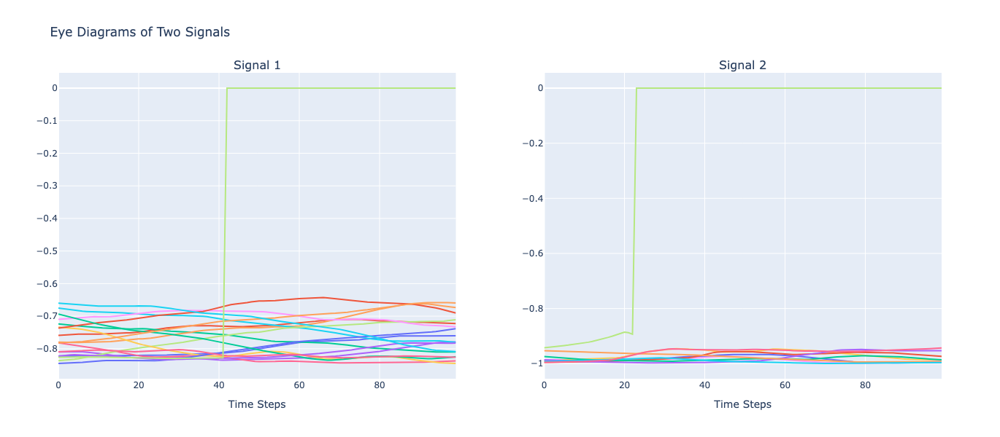

In [9]:
eye_diag_2(squat[1]['gravityX'].dropna().to_numpy(), bench[1]['gravityX'].dropna().to_numpy(), 100)

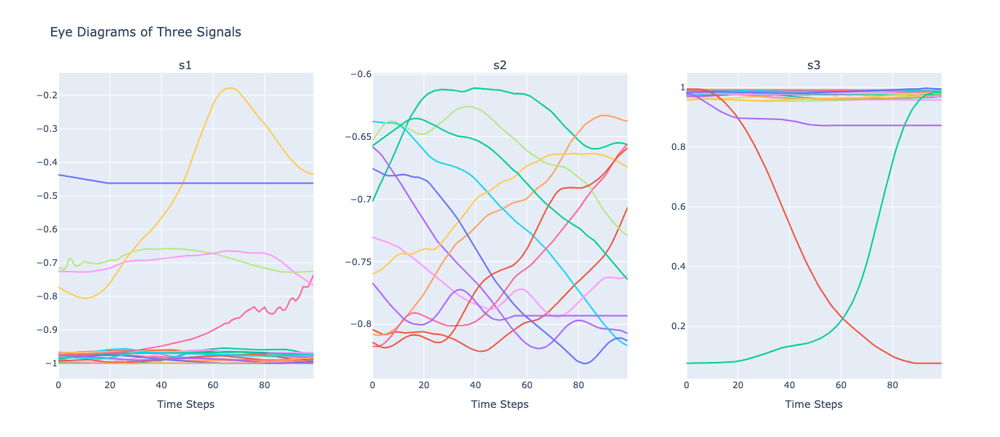

In [10]:
def eye_diag_3(sig1, sig2, sig3, interval, names=("s1", "s2", "s3"), normalize = False):
    def process_signal(sig, interval):
        if normalize:
            mean = np.mean(sig)
            std = np.std(sig)
            sig = (sig - mean)/std
        if interval not in sig.shape:
            sig = sig.reshape(-1, 1)
        pad_len = interval - (sig.shape[0] % interval)
        if pad_len != interval:
            padding = np.zeros((pad_len, sig.shape[1]))
            padding[:, :] = sig[-1, -1]
            sig = np.concatenate([sig, padding], axis=0)
        sig = sig.reshape(-1, interval, sig.shape[1])
        sig = np.squeeze(sig)

        return sig

    sig1_proc = process_signal(sig1, interval)
    sig2_proc = process_signal(sig2, interval)
    sig3_proc = process_signal(sig3, interval)


    fig = make_subplots(rows=1, cols=3, subplot_titles=names)

    # Plot sig1
    for e in sig1_proc:
        fig.add_trace(
            go.Scatter(x=list(range(len(e))), y=e, showlegend=False),
            row=1, col=1
        )

    # Plot sig2
    for e in sig2_proc:
        fig.add_trace(
            go.Scatter(x=list(range(len(e))), y=e, showlegend=False),
            row=1, col=2
        )

    for e in sig3_proc:
        fig.add_trace(
            go.Scatter(x=list(range(len(e))), y=e, showlegend=False),
            row=1, col=3
        )

    fig.update_layout(
        height=600,
        width=1000,
        #yaxis_range = [-1, 1],
        title_text="Eye Diagrams of Three Signals",
        hovermode="x unified"
    )

    fig.update_xaxes(title_text="Time Steps", row=1, col=1)
    fig.update_xaxes(title_text="Time Steps", row=1, col=2)
    fig.update_xaxes(title_text="Time Steps", row=1, col=3)


    fig.show()

eye_diag_3(bench[0]['gravityX'].dropna().to_numpy(), squat[0]['gravityX'].dropna().to_numpy(), deadlift[0]['gravityX'].dropna().to_numpy(), 100)

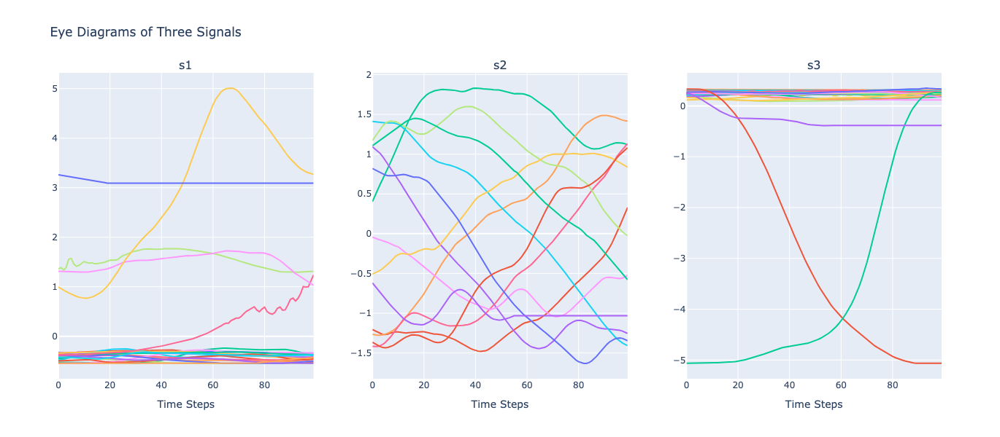

In [11]:
eye_diag_3(bench[0]['gravityX'].dropna().to_numpy(), squat[0]['gravityX'].dropna().to_numpy(), deadlift[0]['gravityX'].dropna().to_numpy(), 100, normalize=True)

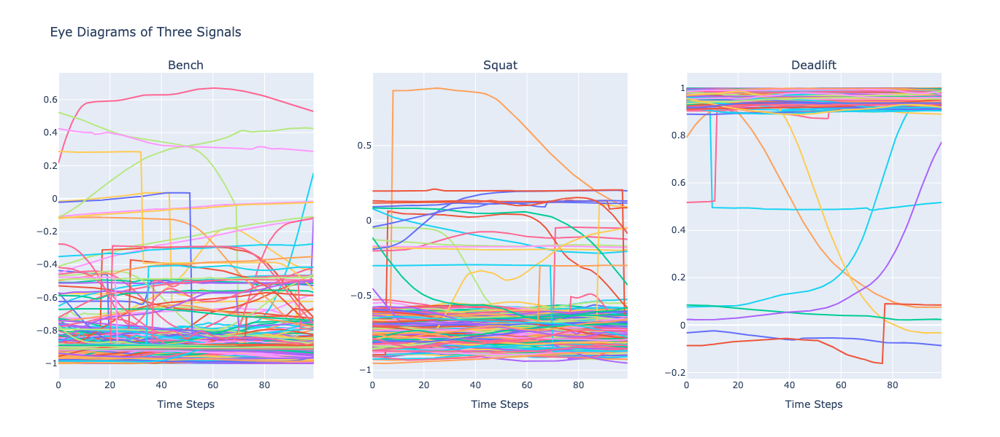

In [12]:
bench_all = np.concatenate([df['gravityX'].dropna().to_numpy() for df in bench])
squat_all = np.concatenate([df['gravityX'].dropna().to_numpy() for df in squat])
deadlift_all = np.concatenate([df['gravityX'].dropna().to_numpy() for df in deadlift])

# Reshape for compatibility
bench_all = bench_all.reshape(-1, 1)
squat_all = squat_all.reshape(-1, 1)
deadlift_all = deadlift_all.reshape(-1, 1)

# Plot
eye_diag_3(bench_all, squat_all, deadlift_all, interval=100, names=("Bench", "Squat", "Deadlift"))


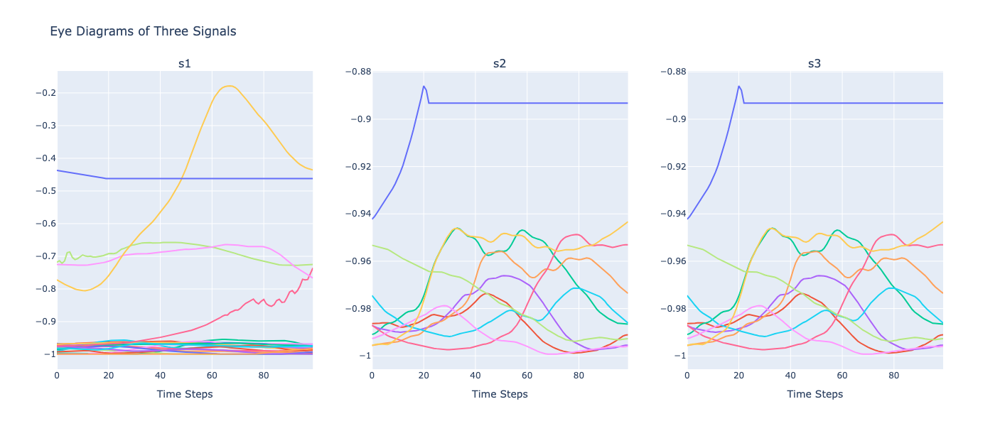

In [13]:
eye_diag_3(bench[0]['gravityX'].dropna().to_numpy(), bench[1]['gravityX'].dropna().to_numpy(), bench[1]['gravityX'].dropna().to_numpy(), 100)

In [13]:
eye_diag_3(bench[2]['gravityX'].dropna().to_numpy(), bench[3]['gravityX'].dropna().to_numpy(), bench[4]['gravityX'].dropna().to_numpy(), 100)

In [14]:
i = 1

In [ ]:
eye_diag_3(bench[i]['gravityX'].dropna().to_numpy(), squat[i]['gravityX'].dropna().to_numpy(), deadlift[i]['gravityX'].dropna().to_numpy(), 100)

In [ ]:
eye_diag_3(bench[i]['gravityY'].dropna().to_numpy(), squat[i]['gravityY'].dropna().to_numpy(), deadlift[i]['gravityY'].dropna().to_numpy(), 100)

In [ ]:
eye_diag_3(bench[i]['gravityZ'].dropna().to_numpy(), squat[i]['gravityZ'].dropna().to_numpy(), deadlift[i]['gravityZ'].dropna().to_numpy(), 100)

In [ ]:
def process_signal(sig, interval, normalize=False):
    if interval not in sig.shape:
        sig = sig.reshape(-1, 1)
    pad_len = interval - (sig.shape[0] % interval)
    if pad_len != interval:
        padding = np.zeros((pad_len, sig.shape[1]))
        padding[:, :] = sig[-1, -1]
        sig = np.concatenate([sig, padding], axis=0)
    sig = sig.reshape(-1, interval, sig.shape[1])
    sig = np.squeeze(sig)
    return sig/np.max(np.abs(sig)) if normalize else sig

def get_mean_std_tensor(sig, interval, normalize=False):
    temp = process_signal(sig, interval, normalize)
    tensor = np.vstack([np.average(temp, axis=0), np.std(temp, axis=0)]).T
    return tensor



In [ ]:

bench_tensor_temp = bench[1]['gravityX'].dropna().to_numpy()
bench_tensor_temp = get_mean_std_tensor(bench_tensor_temp, interval)

squat_tensor_temp = squat[0]['gravityX'].dropna().to_numpy()
squat_tensor_temp = get_mean_std_tensor(squat_tensor_temp, interval)

deadlift_tensor_temp = deadlift[12]['gravityY'].dropna().to_numpy()
deadlift_tensor_temp = get_mean_std_tensor(deadlift_tensor_temp, interval)

plt.scatter(squat_tensor_temp[:, 0], squat_tensor_temp[:, 1], label='squat points')
plt.scatter(np.average(squat_tensor_temp[:, 0]), np.average(squat_tensor_temp[:, 1]), label='squat avg')

plt.scatter(bench_tensor_temp[:, 0], bench_tensor_temp[:, 1], label='bench points')
plt.scatter(np.average(bench_tensor_temp[:, 0]), np.average(bench_tensor_temp[:, 1]), label='bench avg')

plt.scatter(deadlift_tensor_temp[:, 0], deadlift_tensor_temp[:, 1], label='deadlift points')
plt.scatter(np.average(deadlift_tensor_temp[:, 0]), np.average(deadlift_tensor_temp[:, 1]), label='deadlift avg')
plt.legend()

In [ ]:

bench_tensor_temp = bench[0]['gravityX'].dropna().to_numpy()
bench_tensor_temp = get_mean_std_tensor(bench_tensor_temp, interval, normalize=True)

squat_tensor_temp = squat[0]['gravityX'].dropna().to_numpy()
squat_tensor_temp = get_mean_std_tensor(squat_tensor_temp, interval, normalize=True)

deadlift_tensor_temp = deadlift[0]['gravityX'].dropna().to_numpy()
deadlift_tensor_temp = get_mean_std_tensor(deadlift_tensor_temp, interval, normalize=True)

plt.scatter(squat_tensor_temp[:, 0], squat_tensor_temp[:, 1], label='squat points')
plt.scatter(np.average(squat_tensor_temp[:, 0]), np.average(squat_tensor_temp[:, 1]), label='squat avg')

plt.scatter(bench_tensor_temp[:, 0], bench_tensor_temp[:, 1], label='bench points')
plt.scatter(np.average(bench_tensor_temp[:, 0]), np.average(bench_tensor_temp[:, 1]), label='bench avg')

plt.scatter(deadlift_tensor_temp[:, 0], deadlift_tensor_temp[:, 1], label='deadlift points')
plt.scatter(np.average(deadlift_tensor_temp[:, 0]), np.average(deadlift_tensor_temp[:, 1]), label='deadlift avg')

plt.legend()

In [ ]:
plt.scatter(bench_tensor_temp[:, 0], bench_tensor_temp[:, 1], label='squat points')
plt.scatter(np.average(bench_tensor_temp[:, 0]), np.average(bench_tensor_temp[:, 1]), label='squat avg')

In [ ]:
squat_tensor_temp = squat[0]['gravityZ'].dropna().to_numpy()
squat_tensor_temp = get_mean_std_tensor(squat_tensor_temp, interval, normalize=True)
plt.scatter(squat_tensor_temp[:, 0], squat_tensor_temp[:, 1], label='squat points')
plt.scatter(np.average(squat_tensor_temp[:, 0]), np.average(squat_tensor_temp[:, 1]), label='squat avg')

In [ ]:
squat_tensor_temp = bench[0]['gravityZ'].dropna().to_numpy()
squat_tensor_temp = get_mean_std_tensor(squat_tensor_temp, interval, normalize=True)
plt.scatter(squat_tensor_temp[:, 0], squat_tensor_temp[:, 1], label='squat points')
plt.scatter(np.average(squat_tensor_temp[:, 0]), np.average(squat_tensor_temp[:, 1]), label='squat avg')

In [ ]:
squat_tensor_temp = deadlift[0]['gravityZ'].dropna().to_numpy()
squat_tensor_temp = get_mean_std_tensor(squat_tensor_temp, interval, normalize=True)
plt.scatter(squat_tensor_temp[:, 0], squat_tensor_temp[:, 1], label='squat points')
plt.scatter(np.average(squat_tensor_temp[:, 0]), np.average(squat_tensor_temp[:, 1]), label='squat avg')

In [ ]:
all_bench = []
all_squat = []
all_bench_avg = []
all_squat_avg = []
all_deadlift = []
all_deadlift_avg = []


for e in squat:
    squat_tensor = e['gravityX'].dropna().to_numpy()
    squat_tensor = get_mean_std_tensor(squat_tensor, interval)
    all_squat.append(squat_tensor)
    all_squat_avg.append(np.average(squat_tensor, axis=0))


for e in bench:
    bench_tensor = e['gravityX'].dropna().to_numpy()
    bench_tensor = get_mean_std_tensor(bench_tensor, interval)
    all_bench.append(squat_tensor)
    all_bench_avg.append(np.average(squat_tensor, axis=0))




#all_bench = np.vstack(all_bench)
plt.scatter(all_bench[:][0], all_bench[:][1], label='bench points')
plt.scatter(all_bench_avg[:][0], all_bench_avg[:][1], label='bench avg')

plt.scatter(all_squat[:][0], all_bench[:][1], label='squat points')
plt.scatter(all_squat_avg[:][0], all_bench_avg[:][1], label='squat avg')



plt.legend()
plt.xlabel('mean')
plt.ylabel('std')
plt.title('Gravity X STD vs Mean')

In [ ]:
all_bench = []
all_squat = []
all_bench_avg = []
all_squat_avg = []
all_deadlift = []
all_deadlift_avg = []

label = 'gravityY'
for e in squat:
    squat_tensor = e[label].dropna().to_numpy()
    squat_tensor = get_mean_std_tensor(squat_tensor, interval)
    all_squat.append(squat_tensor)
    all_squat_avg.append(np.average(squat_tensor, axis=0))



for e in bench:
    bench_tensor = e[label].dropna().to_numpy()
    bench_tensor = get_mean_std_tensor(bench_tensor, interval)
    all_bench.append(squat_tensor)
    all_bench_avg.append(np.average(squat_tensor, axis=0))


for e in deadlift:
    deadlift_tensor = e[label].dropna().to_numpy()
    deadlift_tensor = get_mean_std_tensor(deadlift_tensor, interval)
    all_deadlift.append(deadlift_tensor)
    all_deadlift_avg.append(np.average(deadlift_tensor, axis=0))


#all_bench = np.vstack(all_bench)
plt.scatter(all_bench[:][0], all_bench[:][1], label='bench points')
plt.scatter(all_bench_avg[:][0], all_bench_avg[:][1], label='bench avg')

plt.scatter(all_squat[:][0], all_bench[:][1], label='squat points')
plt.scatter(all_squat_avg[:][0], all_bench_avg[:][1], label='squat avg')


plt.scatter(all_deadlift[:][0], all_deadlift[:][1], label='deadlift points')
plt.scatter(all_deadlift_avg[:][0], all_deadlift_avg[:][1], label='deadlift avg')


plt.legend()
plt.xlabel('mean')
plt.ylabel('std')
plt.title('Gravity X STD vs Mean')

In [ ]:
def plot_mean_std(label, num=5, interval = interval, normalize=False):
    all_bench = []
    all_squat = []
    all_bench_avg = []
    all_squat_avg = []
    all_deadlift = []
    all_deadlift_avg = []
    
    for i, e in enumerate(squat):
        if num is None or i < num:
            squat_tensor = e[label].dropna().to_numpy()
            squat_tensor = get_mean_std_tensor(squat_tensor, interval, normalize)
            all_squat.append(squat_tensor)
            all_squat_avg.append(np.average(squat_tensor, axis=0))
        
    
    
    for i, e in enumerate(bench):
        if num is None or i < num:
            bench_tensor = e[label].dropna().to_numpy()
            bench_tensor = get_mean_std_tensor(bench_tensor, interval, normalize)
            all_bench.append(squat_tensor)
            all_bench_avg.append(np.average(squat_tensor, axis=0))
    
    
    for i, e in enumerate(deadlift):
        if num is None or i < num:
            deadlift_tensor = e[label].dropna().to_numpy()
            deadlift_tensor = get_mean_std_tensor(deadlift_tensor, interval, normalize)
            all_deadlift.append(deadlift_tensor)
            all_deadlift_avg.append(np.average(deadlift_tensor, axis=0))
            if all_deadlift_avg[-1][1] < 0:
                print(i)
    
    #all_bench = np.vstack(all_bench)
    plt.scatter(all_bench[:][0], all_bench[:][1], label='bench points')
    plt.scatter(all_bench_avg[:][0], all_bench_avg[:][1], label='bench avg')
    
    plt.scatter(all_squat[:][0], all_bench[:][1], label='squat points')
    plt.scatter(all_squat_avg[:][0], all_bench_avg[:][1], label='squat avg')
    
    
    plt.scatter(all_deadlift[:][0], all_deadlift[:][1], label='deadlift points')
    plt.scatter(all_deadlift_avg[:][0], all_deadlift_avg[:][1], label='deadlift avg')
    
    print(len(all_squat_avg))
    plt.legend()
    plt.xlabel('mean')
    plt.ylabel('std')
    plt.title(f'{label} STD vs Mean')

plot_mean_std('gravityZ', num = None, normalize=True)

In [ ]:
plot_mean_std('rotationRateZ', num = 6, interval = 50)

In [ ]:
plot_mean_std('gravityY', num = None, interval = 300)